## HOG & Landmarks face recognition

In [13]:
#!pip install cmake
#!pip install dlib
#!pip install dlib opencv-python
#!pip install imutils

In [50]:
import dlib
import cv2
import numpy as np
import plotly.express as px
from skimage import io
from imutils import face_utils
import os
from sklearn.svm import SVC
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from PIL import Image
import plotly.graph_objects as go
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
from keras.utils import to_categorical
from keras.models import load_model

## HOG Face Detection 

In [3]:
image = cv2.imread('hogwarts.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

In [5]:
face_detector = dlib.get_frontal_face_detector()

rects = face_detector(gray, 1)
for (i, rect) in enumerate(rects):
        (x, y, w, h) = face_utils.rect_to_bb(rect)
        cv2.rectangle(image, (x, y), (x + w, y + h), (3, 91, 255), 3)


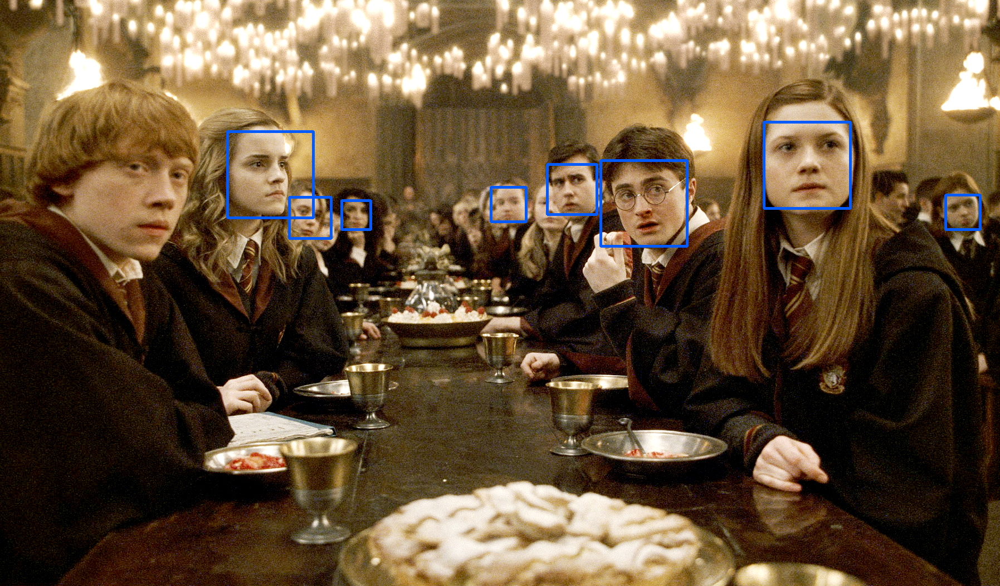

In [6]:
fig = px.imshow(image)
fig.show()

## Landmarks Face Detection

In [7]:
detector = dlib.get_frontal_face_detector()
predictor = dlib.shape_predictor('shape_predictor_68_face_landmarks.dat')

In [14]:
image = cv2.imread('hogwarts.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

faces = detector(gray)

In [15]:
for face in faces:
    landmarks = predictor(gray, face)
    landmarks = np.array([(landmarks.part(i).x, landmarks.part(i).y) for i in range(68)])
    
    # Draw facial landmarks on the image
    for (x, y) in landmarks:
        cv2.circle(image, (x, y), 2, (3, 91, 255), 5)


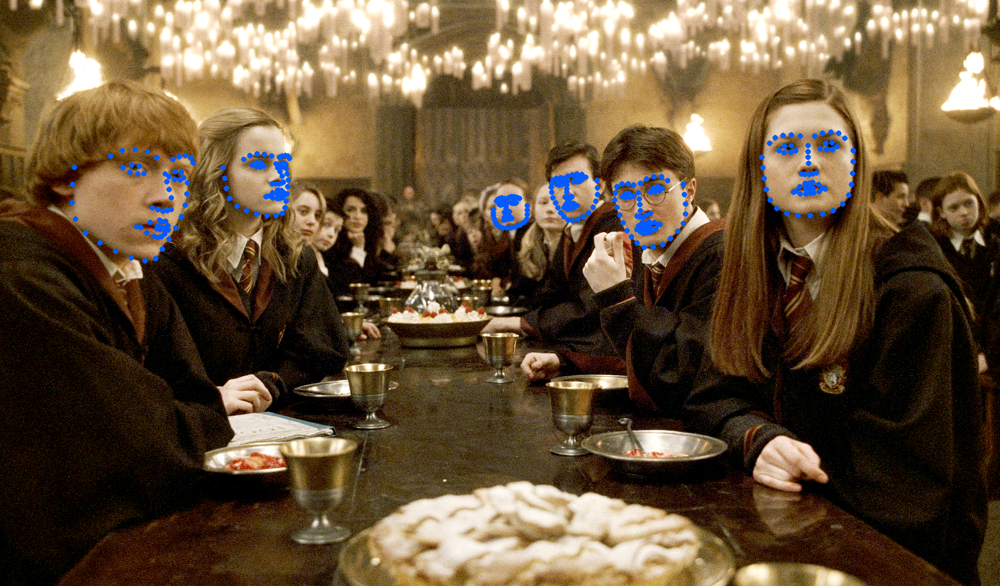

In [16]:
fig = px.imshow(image)
fig.show()

## Landmarks Detection with RGB image


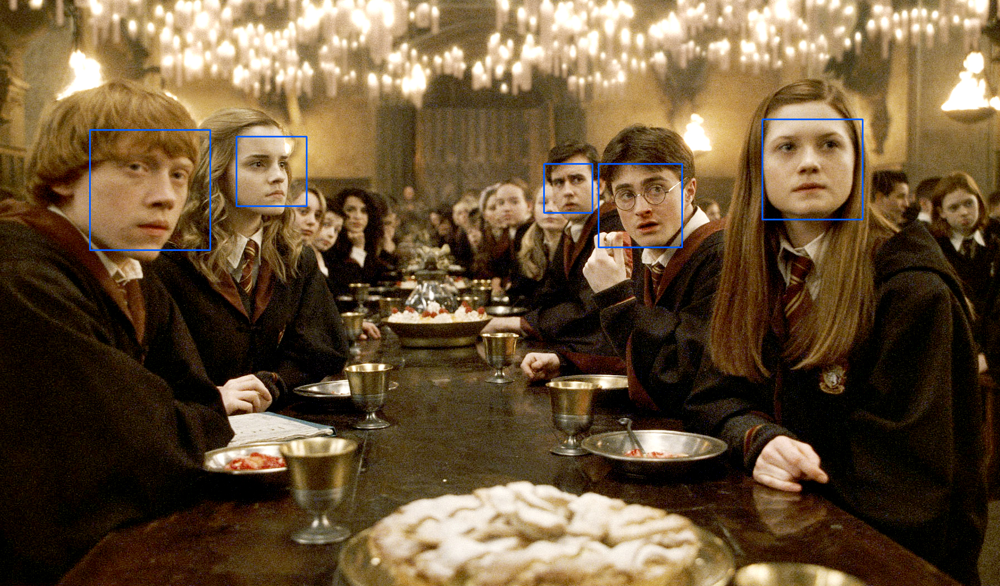

In [33]:
image = cv2.imread('hogwarts.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
faces = detector(image)


for face in faces:
    # Get the landmarks for the face
    landmarks = predictor(gray, face)

    # Extract the coordinates of the bounding box
    x = face.left()
    y = face.top()
    w = face.width()
    h = face.height()

    # Draw a rectangle around the face
    cv2.rectangle(image, (x, y), (x+w, y+h), (3, 91, 255), 2)
    
    

fig = px.imshow(image)

# Show the figure
fig.show()

## Landmarks Detection with Gray Image


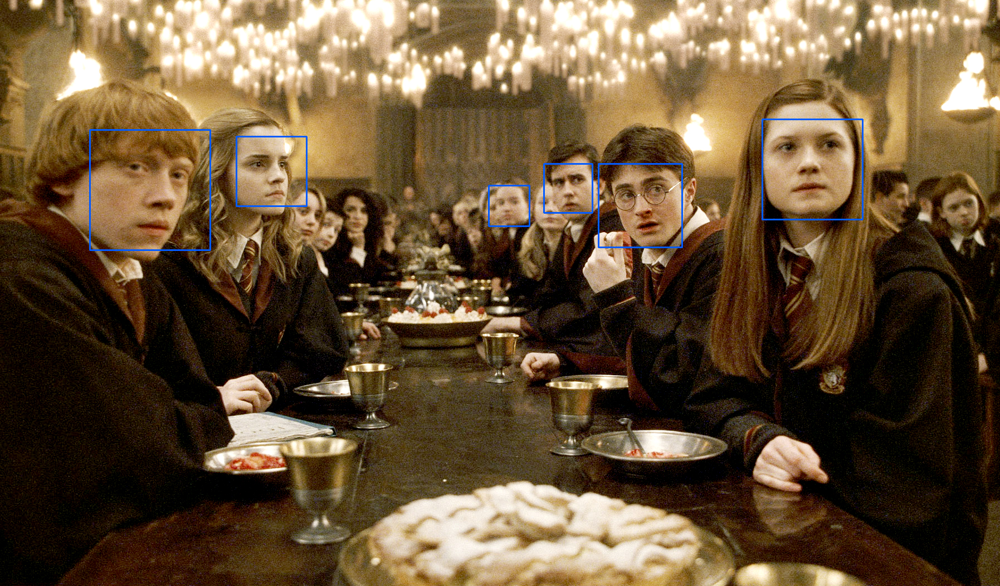

In [34]:
image = cv2.imread('hogwarts.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
faces = detector(gray)

for face in faces:
    # Get the landmarks for the face
    landmarks = predictor(gray, face)

    # Extract the coordinates of the bounding box
    x = face.left()
    y = face.top()
    w = face.width()
    h = face.height()

    # Draw a rectangle around the face
    cv2.rectangle(image, (x, y), (x+w, y+h), (3, 91, 255), 2)
    
    

fig = px.imshow(image)

# Show the figure
fig.show()

## Face Recognition

In [87]:
dataset_path = 'dataset'

face_detector = dlib.get_frontal_face_detector()

# Load the shape predictor from dlib for landmark detection
landmark_predictor = dlib.shape_predictor('shape_predictor_68_face_landmarks.dat')

# Load the dataset
X = []
y = []
    
def extract_face(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    faces = face_detector(gray_image)
    if len(faces) > 0:
        face = faces[0]
        landmarks = landmark_predictor(gray_image, face)
        (x, y, w, h) = cv2.boundingRect(np.array([[p.x, p.y] for p in landmarks.parts()]))
        if (x > 0 and y > 0):
            face_image = gray_image[y:y+h, x:x+w]
            resized_image = cv2.resize(face_image, (100, 100))
            return resized_image

# Iterate over the actor folders
for actor_folder in os.listdir(dataset_path):
    actor_folder_path = os.path.join(dataset_path, actor_folder)
    if os.path.isdir(actor_folder_path):
        # Iterate over the images inside the actor folder
        for image_file in os.listdir(actor_folder_path):
            image_path = os.path.join(actor_folder_path, image_file)
            if os.path.isfile(image_path):
                # Load the image
                image = cv2.imread(image_path)

                # Extract the face region from the image
                face_image = extract_face(image)

                if face_image is not None:
                    # Append the face image and the corresponding label
                    X.append(face_image)
                    y.append(actor_folder)

In [88]:
# Convert the lists to NumPy arrays
X = np.array(X)
y = np.array(y)

# Perform label encoding on the target labels
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

In [89]:
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalize the input images
X_train = X_train.astype('float32') / 255.0
X_test = X_test.astype('float32') / 255.0

In [90]:
# Convert the target labels to categorical format
num_classes = len(label_encoder.classes_)
y_train = to_categorical(y_train, num_classes)
y_test = to_categorical(y_test, num_classes)

In [91]:
# Build the CNN model
model = Sequential()
model.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(100, 100, 1)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, kernel_size=(3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(num_classes, activation='softmax'))

In [92]:
# Compile the model
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])


In [93]:
# Train the model
model.fit(X_train, y_train, batch_size=32, epochs=10, validation_data=(X_test, y_test))

# Save the trained model
model.save('face_recognition_model.h5')
np.save('label_encoder_classes.npy', label_encoder.classes_)

Epoch 1/10
6/6 [==============================] - 1s 177ms/step - loss: 0.8388 - accuracy: 0.5278 - val_loss: 0.6924 - val_accuracy: 0.3696
Epoch 2/10
6/6 [==============================] - 1s 159ms/step - loss: 0.5629 - accuracy: 0.8444 - val_loss: 0.4578 - val_accuracy: 0.8913
Epoch 3/10
6/6 [==============================] - 1s 151ms/step - loss: 0.3567 - accuracy: 0.9278 - val_loss: 0.6066 - val_accuracy: 0.6739
Epoch 4/10
6/6 [==============================] - 1s 156ms/step - loss: 0.2340 - accuracy: 0.9278 - val_loss: 0.2357 - val_accuracy: 0.9130
Epoch 5/10
6/6 [==============================] - 1s 160ms/step - loss: 0.1671 - accuracy: 0.9500 - val_loss: 0.1778 - val_accuracy: 0.9130
Epoch 6/10
6/6 [==============================] - 1s 159ms/step - loss: 0.1043 - accuracy: 0.9611 - val_loss: 0.2588 - val_accuracy: 0.8913
Epoch 7/10
6/6 [==============================] - 1s 160ms/step - loss: 0.0429 - accuracy: 0.9944 - val_loss: 0.1722 - val_accuracy: 0.9130
Epoch 8/10
6/6 [====

1/1 [==============================] - 0s 40ms/step
pins_Rihanna



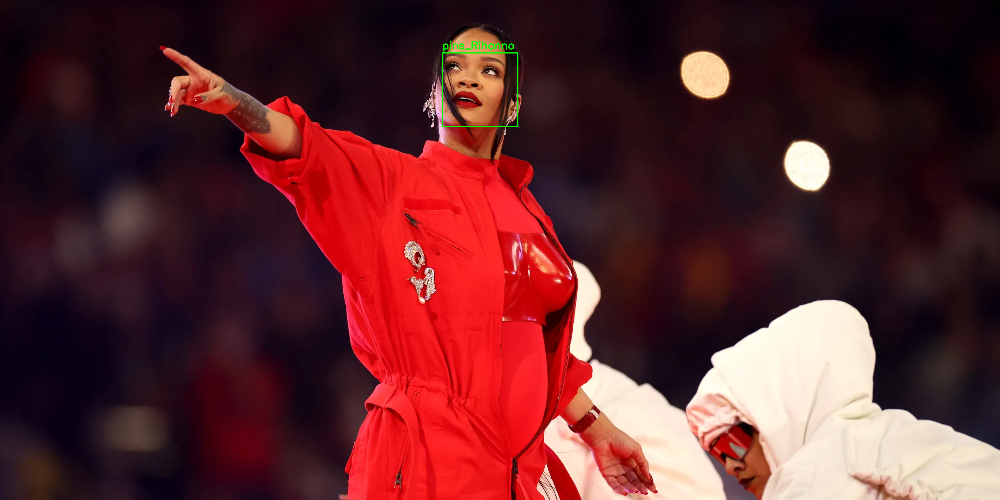

In [97]:
# Load the trained model
model = load_model('face_recognition_model.h5')

# Load the label encoder
label_encoder = LabelEncoder()
label_encoder.classes_ = np.load('label_encoder_classes.npy', allow_pickle=True)

# Load the face detector and landmark predictor from dlib
face_detector = dlib.get_frontal_face_detector()
landmark_predictor = dlib.shape_predictor('shape_predictor_68_face_landmarks.dat')

# Function to preprocess the image
def preprocess_image(image):
    resized_image = cv2.resize(image, (100, 100))
    grayscale_image = cv2.cvtColor(resized_image, cv2.COLOR_BGR2GRAY)
    normalized_image = grayscale_image.astype('float32') / 255.0
    preprocessed_image = np.expand_dims(normalized_image, axis=-1)
    return preprocessed_image

# Function to perform face recognition
def recognize_face(image):
    preprocessed_image = preprocess_image(image)
    preprocessed_image_batch = np.expand_dims(preprocessed_image, axis=0)
    prediction = model.predict(preprocessed_image_batch)
    predicted_class = np.argmax(prediction)
    predicted_label = label_encoder.inverse_transform([predicted_class])[0]
    return predicted_label

# Path to the test image
test_image_path = 'rihanna-super-bowl.webp'

# Load the test image
test_image = cv2.imread(test_image_path)
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)

# Convert the test image to grayscale
gray_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2GRAY)

# Detect faces in the grayscale image
faces = face_detector(gray_image)

# Iterate over the detected faces
for face in faces:
    # Get the facial landmarks
    landmarks = landmark_predictor(gray_image, face)

    # Convert the landmarks to a numpy array
    landmarks_array = np.array([[p.x, p.y] for p in landmarks.parts()])

    # Extract the region of interest (face) from the test image
    (x, y, w, h) = cv2.boundingRect(landmarks_array)
    face_image = test_image[y:y+h, x:x+w]

    # Perform face recognition on the extracted face
    predicted_actor = recognize_face(face_image)

    # Draw a rectangle around the face in the original image
    cv2.rectangle(test_image, (x, y), (x+w, y+h), (0, 255, 0), 2)

    # Write the name of the actor on the image
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(test_image, predicted_actor, (x, y-10), font, 0.9, (0, 255, 0), 2)
    print(predicted_actor)
    
fig = px.imshow(test_image)

# Show the figure
fig.show()